In [1]:
import numpy as np
import imageio.v3 as iio
import skimage as ski
import matplotlib.pyplot as plt
from scipy import ndimage
from skimage.morphology import disk, opening, skeletonize, closing, thin

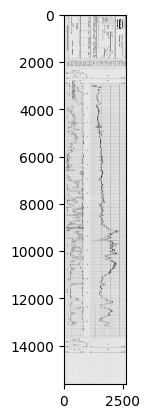

In [2]:
# Load the whole image
#O = iio.imread(uri="testfolder/stampremoved2.tif")
O = iio.imread(uri="../T12073/1930430DualPropResistivityGammaRayLogScanKopi.tif")
# Convert to grayscale
O_gray = ski.color.rgb2gray(O)
# Display the image
plt.imshow(O_gray, cmap="gray")
plt.show()


y: 15634, x: 2628


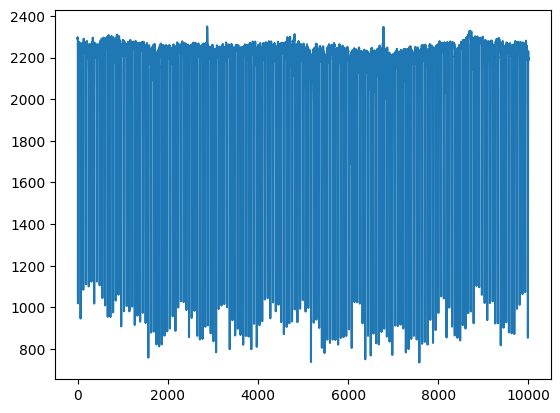

In [3]:
y, x = O_gray.shape[:2]
print(f"y: {y}, x: {x}")
#Read each line of image until the whole line value = white, then remove all lines with that value and all prior
def horizontal_projection(line_pixels):
    return np.sum(line_pixels, axis=1) # Do the same but for other axis when segmenting graphs

tmp = horizontal_projection (O_gray[3000:13000])

plt.plot(tmp)


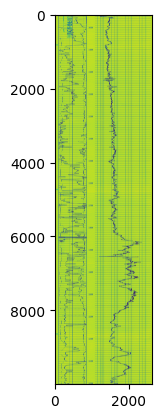

In [4]:
plt.imshow(O_gray[3000:13000])

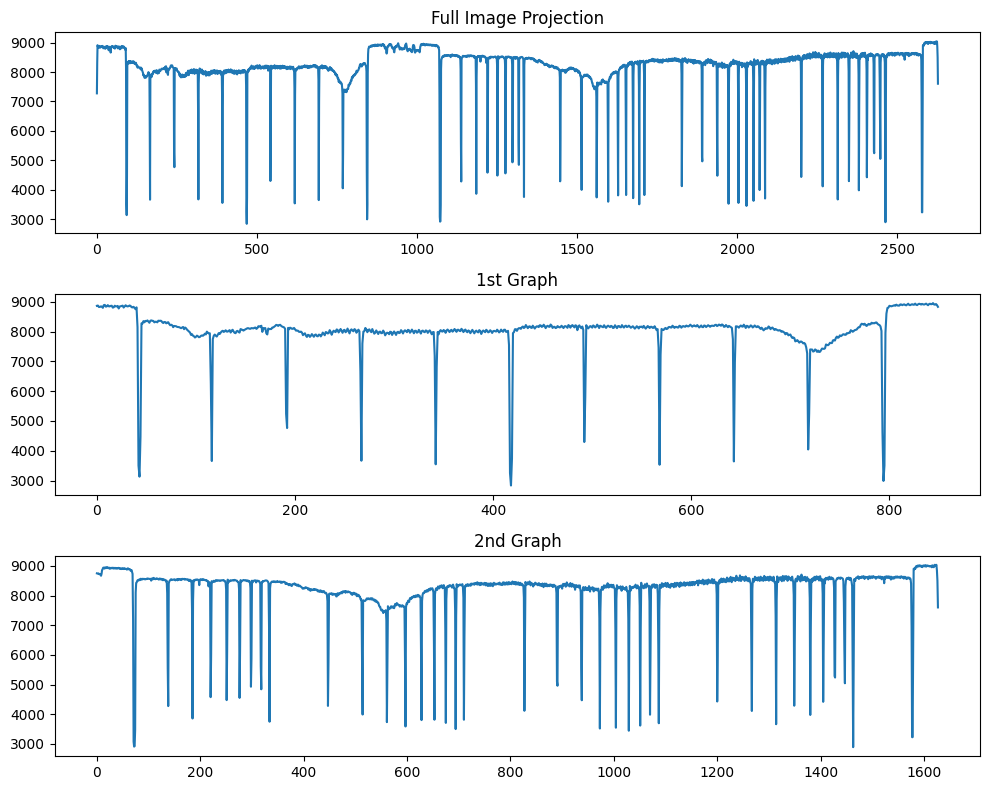

In [5]:
# Looking at the other axis to recognize the different graphs

# Save the interval without the headers
headerless_O = O_gray[3000:13000]

def horizontal_projection(line_pixels):
    return np.sum(line_pixels, axis=0)

tmp = horizontal_projection(headerless_O)

#plt.plot(tmp)

O_graph1 = horizontal_projection(headerless_O[:, 50:900]) 
#plt.plot(O_graph1_x)

O_graph2 = horizontal_projection(headerless_O[:, 1000:]) 

# Create three separate subplots
plt.figure(figsize=(10, 8))  # Optional: specify figure size

# First subplot
plt.subplot(3, 1, 1)
plt.plot(tmp)
plt.title('Full Image Projection')

# Second subplot
plt.subplot(3, 1, 2)
plt.plot(O_graph1)
plt.title('1st Graph')

# Thirs subplot
plt.subplot(3, 1, 3)
plt.plot(O_graph2)
plt.title('2nd Graph')

# Add some spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

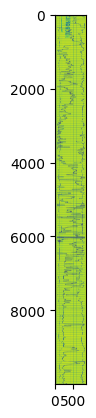

In [6]:
# 1st graph, with the curve
plt.imshow(headerless_O[:, 50:900])

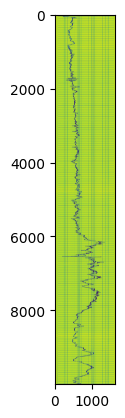

In [7]:
# 2nd graph with nothing on it, really
plt.imshow(headerless_O[:, 1000:])

In [8]:
# Cutting the graph into smaller chunks to work on
headerless_O = O[3000:13000]
grahp1 = headerless_O[:, 50:900]

def chunkify(p_pic):
    threshold = 700
    chunks = []
    
    def split(p_pic):
        if p_pic.shape[0] <= threshold:
            chunks.append(p_pic)
        else:
            half = p_pic.shape[0] // 2
            split(p_pic[:half])
            split(p_pic[half:])
    
    split(p_pic)
    return chunks

graph_chunks = chunkify(grahp1)
for i in graph_chunks:
    print(i.shape)



(625, 850, 3)
(625, 850, 3)
(625, 850, 3)
(625, 850, 3)
(625, 850, 3)
(625, 850, 3)
(625, 850, 3)
(625, 850, 3)
(625, 850, 3)
(625, 850, 3)
(625, 850, 3)
(625, 850, 3)
(625, 850, 3)
(625, 850, 3)
(625, 850, 3)
(625, 850, 3)


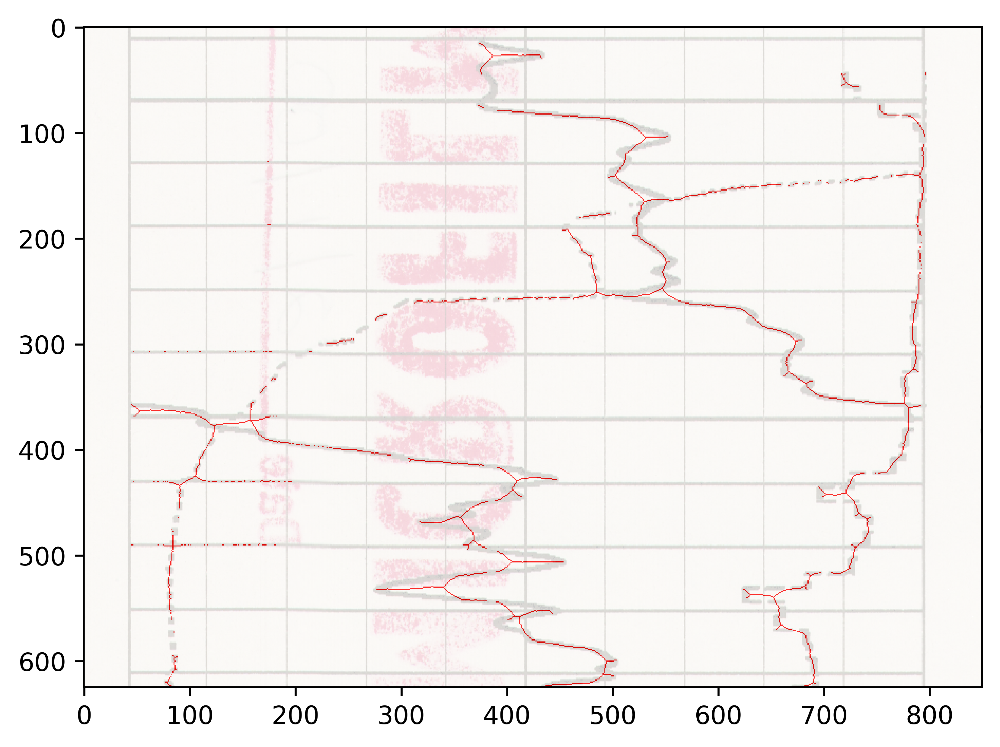

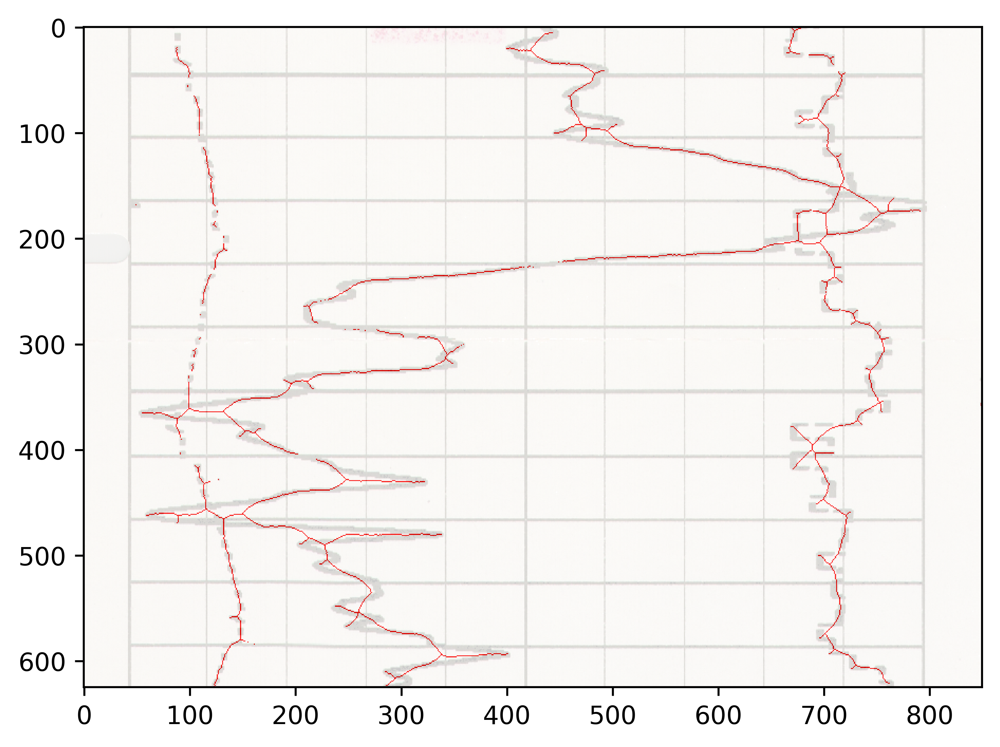

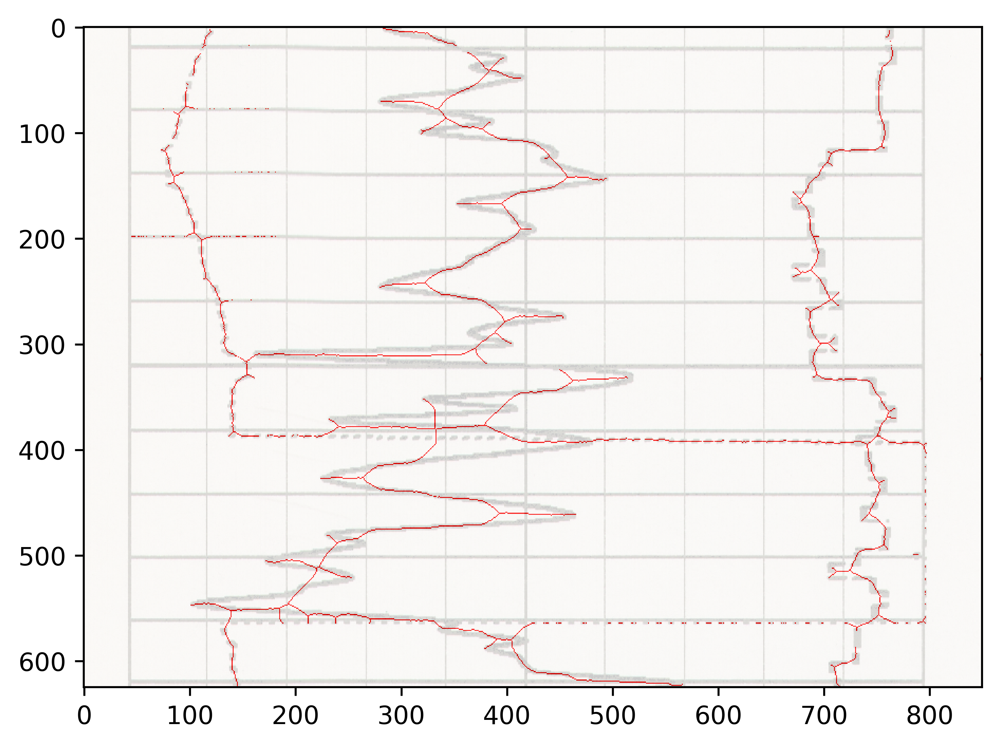

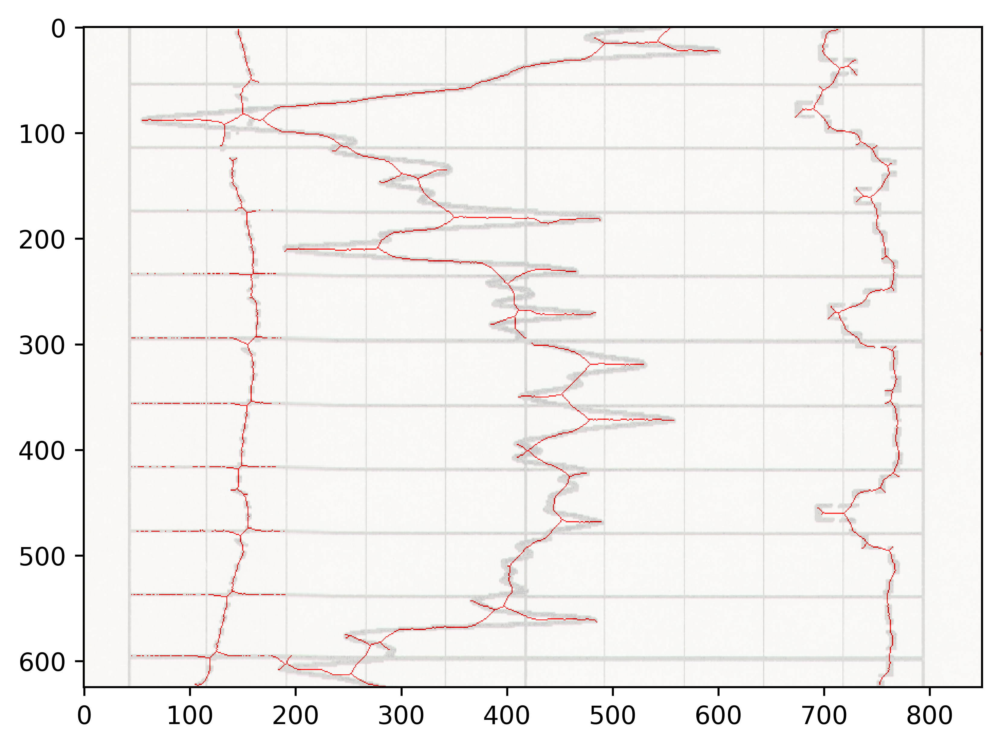

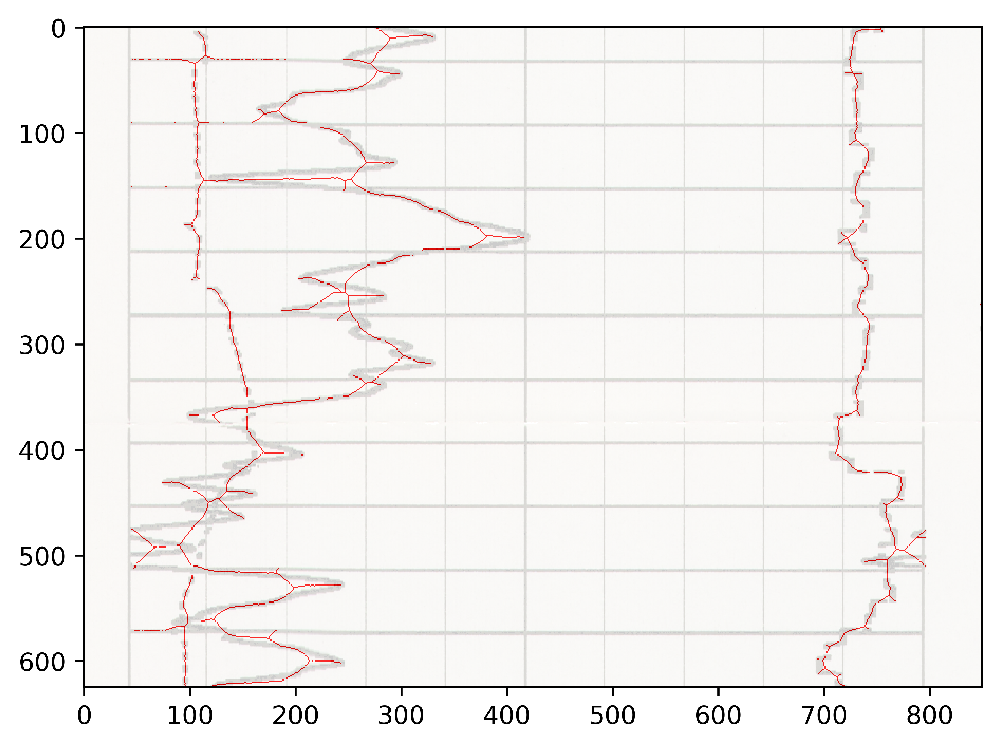

...

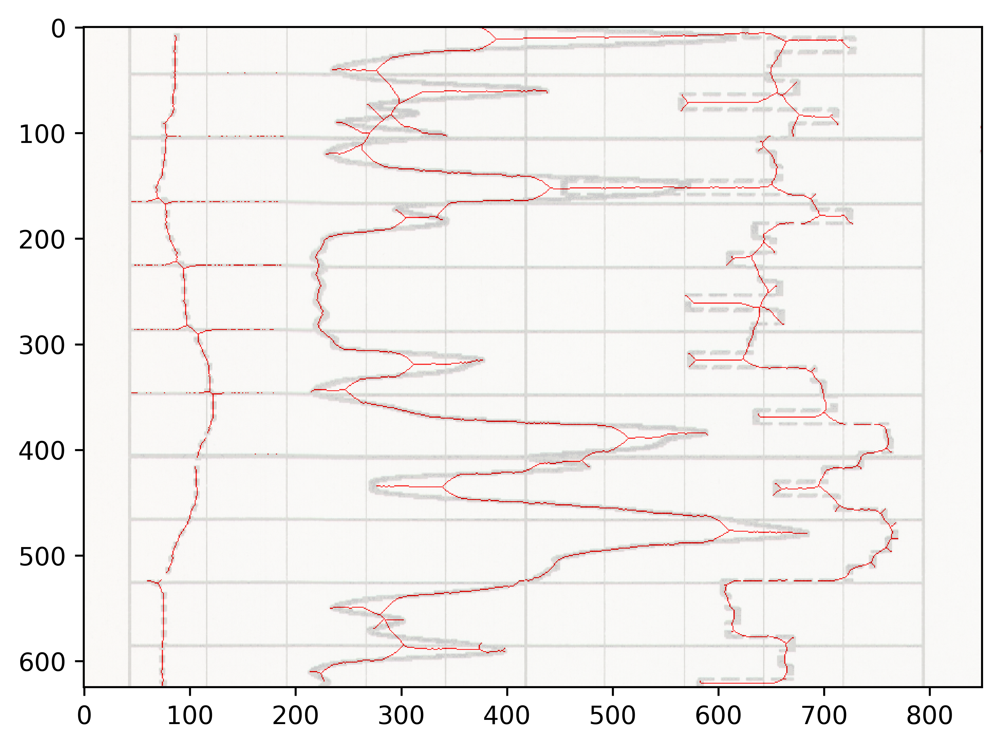

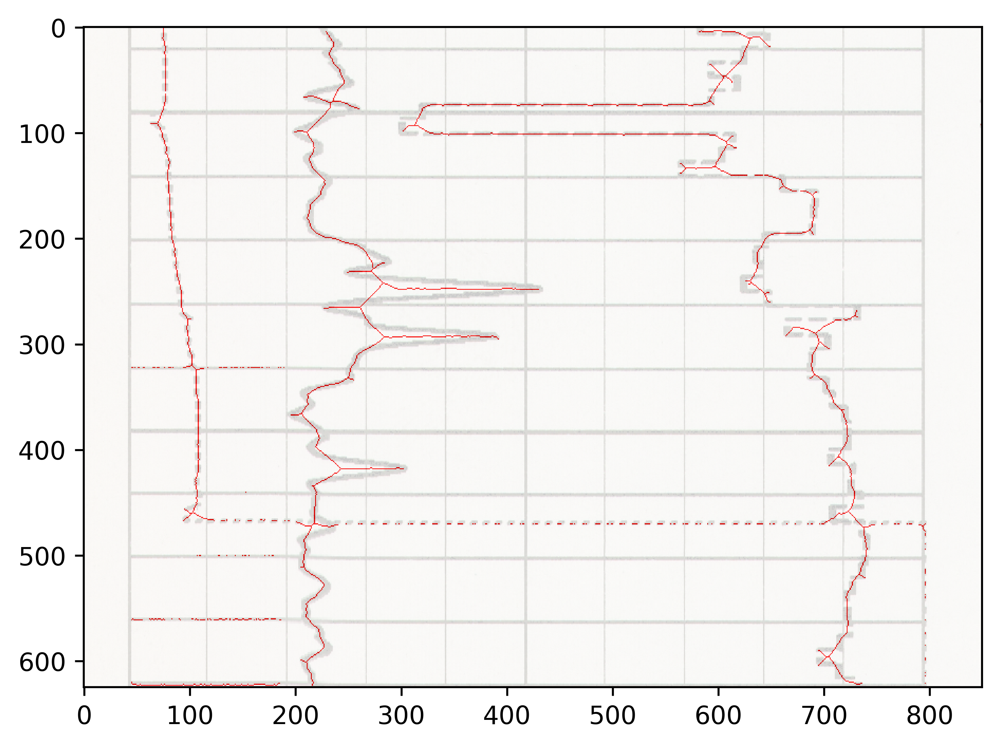

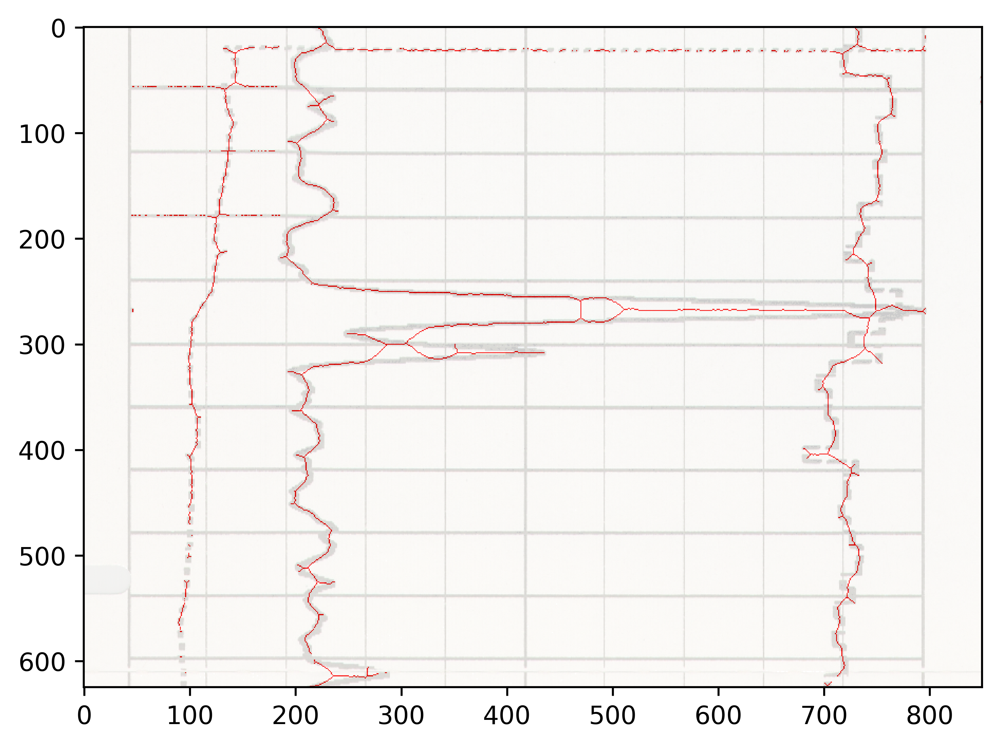

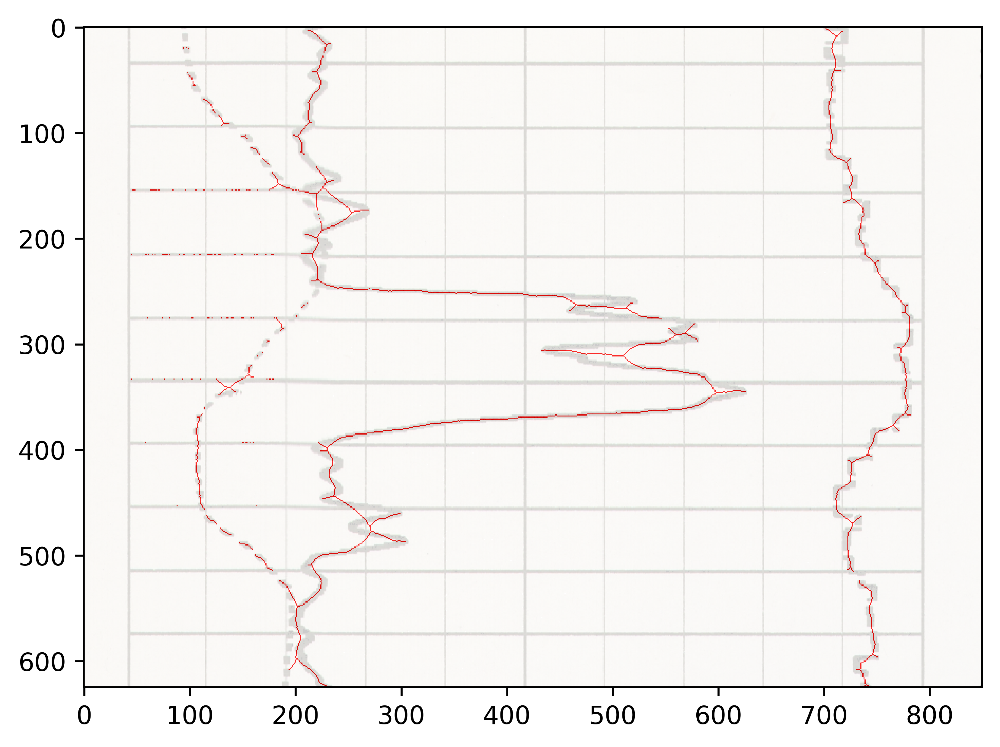

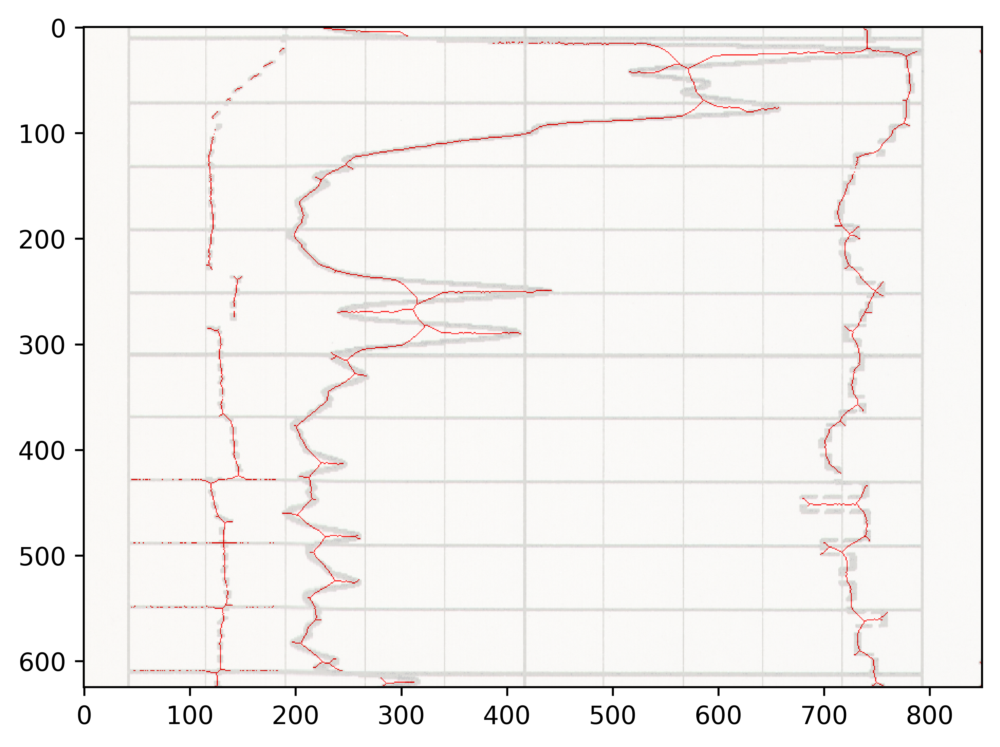

FileNotFoundError: The directory 'c:\\Users\\willi\\OneDrive\\Skrivebord\\Bachelor\\Github\\Digitizing-overlapping-curves\\ClassicCurveisolating\\testfolder' does not exist

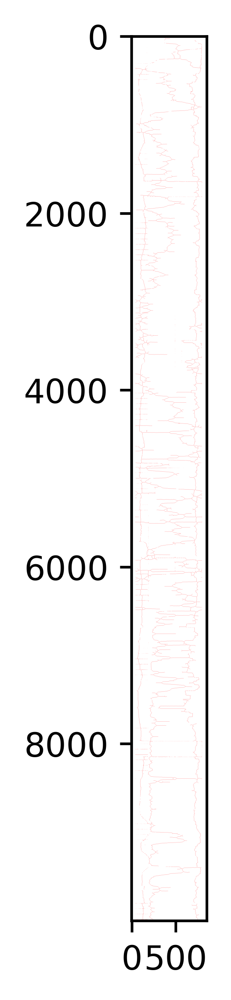

In [9]:

def process_chunks(chunk):
    arrays = []
    counter = 0
    plt.rcParams['figure.dpi'] = 600
    plt.rcParams['savefig.dpi'] = 600
    for i in chunk:
        I_grayg = ski.color.rgb2gray(i)
        # Grayscale
        #print(f'i.shape: \n {i.shape[2]}')
        #print(f'i gray.shape: \n {I_gray.shape}')
        I_grayg = ndimage.gaussian_filter(I_grayg, sigma=1)
        # Attempt with OTSU's method
        threshold = ski.filters.threshold_otsu(I_grayg)
        mask = (I_grayg > threshold)
        min_pixels = 500
        row_mask = np.sum(mask, axis=1) < I_grayg.shape[1]/2#min_pixels
        col_mask = np.sum(mask, axis=0) < I_grayg.shape[0]/2#min_pixels
        #print(f'row mask: \n {row_mask}')
        # Add a new axis and add the maskings to that as well with np.repeat
        #mask_combined = (row_mask[:, np.newaxis] | col_mask[np.newaxis, :])
        
        mask_combined = np.repeat((row_mask[:, np.newaxis] | col_mask[np.newaxis, :])[:, :, np.newaxis], i.shape[2], axis=2)
        #print(f'mask combined: \n {mask_combined}')
        K = np.maximum(i, np.max(i) * mask_combined)
        
        se = disk(10)
        J = opening(K.mean(axis=2),se)
        #S = (J<65)
        S = thin(J<65)
        #plt.figure(figsize=(10,10))
        #plt.subplot(2, 2, 4)
        overlay = np.zeros(i.shape[:2] + (3,), dtype=np.uint8) + 255
        
        overlay[S] = [255, 0, 0]
        plt.imshow(overlay)
        plt.imshow(i, cmap="gray", alpha=0.2)
        plt.axis("image")
        plt.show()
        if counter == 0:
            arrays = overlay
            counter += 1
        else:
            arrays = np.concatenate((arrays,overlay),axis=0)
    return arrays


test = process_chunks(graph_chunks)
plt.imshow(test)
iio.imwrite("testfolder/fulltest22.tif",test)


In [ ]:
""" test = process_chunks(graph_chunks)
plt.imshow(test[0][0:]) """
#iio.imwrite(test[[0][0:]])

' test = process_chunks(graph_chunks)\nplt.imshow(test[0][0:]) '